In [2]:
# Install dependencies
#! pip install opencv-python
#! pip install ultralytics
#! pip install albumentations
#! pip install torch torchvision torchaudio --upgrade

In [3]:
# Do imports here
#from google.colab import drive
import time
import cv2
import os
from ultralytics import YOLO # import YOLO 8
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm, trange
import numpy as np
from glob import glob
import torch
import shutil

In [4]:
torch.cuda.is_available()

True

In [5]:
torch.cuda.device_count()

1

In [6]:
#drive.mount('/content/drive')

In [7]:
# define constants
random_seed = 2024


# Project Overview

The aim of this project is to develop a deep learning model to detect and classify cyclists, pedestrians and vehicles in cities using videos. In our project we prepared a subsample of the really big open source dataset, bdd100k (https://www.vis.xyz/bdd100k/) and used it to train the latest version of the yolo models, yolov8 (https://github.com/ultralytics/ultralytics). After fine tuning your yolo model we compare it with the original yolo model and we proove, that our fine tuned model works a bit better. Our primary objective is to gain hands-on experience with deep learning for road traffic detection, a crucial component for autonomous vehicle navigation.  This Jupyter notebook documents the steps involved in dataset preparation, model training, and performance evaluation.

# Contributions

- Creating the group communication channel(Fabio)
- Communicating with Walter (Nico)
- Dataset preparation (Artin)
- Data augmentation (Thomas & Artin)
- Dataset analysis (Fabio)
- Training the model (Thomas)
- Get reference for a video (Thomas & Artin)
- Having the project on github? (Thomas)
- Results reference experiment (Nico, Thomas)
- Results improve on the reference (Nico, Thomas)
- Look over the finished notebook (Nico, Artin, Thomas, Fabio)

# Set up

% This section should contain a brief description of the steps to follow to run the code.

The whole project was implemented in this Google Colab Jupyter notebook. To run the code, just press run all in this environment. For performance reasons it would be better to run it locally, if you do please check all paths.

# Dataset

## General Information on the dataset

We decided on using 10k images of the BDD100k images datset, because 10k images are already plenty for our task and only using 10k makes the training process faster, in therms of seeing if your net moves in the right direction. These are images which were collected by taking an image from the BDD100k video dataset at every 0.1 seconds. The Data was collected in America (New York, San Francisco, Bay Area and Berkley) and is capturing a wide variety of driving environments, weather conditions, and times of day. It also includes detailed annotations for tasks like object detection, segmentation, and lane detection. The Images are of size 1280x720 and the entire Dataset has 646 MB.

Source of the dataset:
https://www.vis.xyz/bdd100k/

### Labels

Our specific version of the BDD100k dataset has the following labels for object detection:

0: person<br>
1: rider<br>
2: car<br>
3: bus<br>
4: truck<br>
5: bike<br>
6: motor<br>
7: tl_green<br>
8: tl_red<br>
9: tl_yellow<br>
10: tl_none<br>
11: traffic sign<br>
12: train<br>

### Why BDD100k?

BDD100K was one of the datasets which fulfilled our requirements for a good dataset, which were diversity of scenarios, comprehensive annotations and compatibility with yolo. Its over 100,000 images, were captured across different urban environments, weather conditions, and times of day, which provide the necessary variety to train a robust model and the detailed annotations for bicycle, pedestrian, and vehicle align perfectly with our requirements.


Since there are multiple BDD100k annotation files supporting a wide range of different tasks, the annotation files need to be converted into Yolov9 format. While there are already converted label files available online, we found these to be erroneous and therefore used code from the following source to convert the labels ourselves: https://github.com/williamhyin/yolov5s_bdd100k/blob/master/Bdd_preprocessing.ipynb

Our converted and zipped (original) dataset can be found here: https://drive.google.com/drive/folders/1Y-YbA3y2qKDBhQIfvnAhnCPbTX6-5ik8?usp=sharing

We create the following code to obtain our own BDD10k training and validation splits:

In [8]:
# Extract bdd100k dataset (Only needed when running on Google Colab)
#! unzip "drive/MyDrive/JKU/ItAV/task1/dataset/yolo-bdd100k.zip"

In [9]:
# Extract bdd10k dataset
#! unzip "drive/MyDrive/JKU/ItAV/task1/dataset/yolo-bdd10k.zip"

## Dataset preparation

This section should detail your dataset preparation strategy (pre-processing, data augmentation) and justify your approach.

### Get 10K samples from BDD100K

As the Yolo v8 model is already trained on a relatively huge dataset (COCO128), doing transfer learning on the complete BDD100k dataset is unnecessary and takes too much time and resources.

So we take a portion of this dataset and we call it BDD10k, which is not the same as the BDD10k which is released by BAIR but we only take the first 10K data points from BDD100k train set.


In [10]:
# Code used to get 10k images from the BDD100K dataset
# Not needed when BDD-10K is already downloaded or generated!
"""

k10_train_length = 10_000
k10_val_length = np.ceil((10_000 / 70_000) * 10_000) # Take validation set proportional to train set

# Get bdd100k train and validation sample file paths
k100_train_paths = glob(os.path.join('dataset/yolo-bdd100k', 'images', 'train', '*.jpg' ))
k100_val_paths = glob(os.path.join('dataset/yolo-bdd100k', 'images', 'val', '*.jpg' ))

# Create directories for storing bdd10k dataset
! mkdir dataset/yolo-bdd10k
! mkdir dataset/yolo-bdd10k/images
! mkdir dataset/yolo-bdd10k/images/train
! mkdir dataset/yolo-bdd10k/images/val
! mkdir dataset/yolo-bdd10k/labels
! mkdir dataset/yolo-bdd10k/labels/train
! mkdir dataset/yolo-bdd10k/labels/val

for index in trange(k10_train_length):
  if index < k10_val_length:
    image_path = k100_val_paths[index]
    image_dest = image_path.replace('yolo-bdd100k', 'yolo-bdd10k')
    shutil.copy(image_path, image_dest)
    shutil.copy(
        image_path.replace('images', 'labels').replace('jpg', 'txt'),
        image_dest.replace('images', 'labels').replace('jpg', 'txt')
          )
  image_path = k100_train_paths[index]
  image_dest = image_path.replace('yolo-bdd100k', 'yolo-bdd10k')
  shutil.copy(image_path, image_dest)
  try:
    shutil.copy(
          image_path.replace('images', 'labels').replace('jpg', 'txt'),
          image_dest.replace('images', 'labels').replace('jpg', 'txt')
            )
  except FileNotFoundError:
    print(f"No label for {image_path}")


# Make a copy from bdd100k dataset.yaml file
! cp dataset/yolo-bdd100k/dataset.yaml dataset/yolo-bdd10k/dataset.yaml


# Read in the dataset.yaml file
with open('dataset/yolo-bdd10k/dataset.yaml', 'r') as file:
  filedata = file.read()

# Replace bdd100k with bdd10k in yaml file
filedata = filedata.replace('yolo-bdd100k', 'yolo-bdd10k')

# Write the file out again
with open('dataset/yolo-bdd10k/dataset.yaml', 'w') as file:
  file.write(filedata)

# Create a zip from bdd10k dataset files
! zip -r yolo-bdd10k.zip dataset/yolo-bdd10k/

!cp  "./yolo-bdd10k.zip" "./drive/MyDrive/JKU/ItAV/task1/dataset/yolo-bdd10k.zip"
"""
print()

### Data Augmentation

Since Yolo already has an integrated data augmentation strategy and we want to augment preferably during runtime, we will use and discuss Data Augmentation in the Training section.

# Dataset analysis

To ensure robust model training and accurate evaluation, we performed some exploratory data analysis on our dataset. This analysis revealed a similar distribution of samples and object labels across the train and validation sets. However, we identified a few rarely occurring labels, which might make it hard for our model to detect thigs like trains and bikes when trying to detect them in the real world. We also observed a consistent range of object sizes, indicating that our data is generally well-suited for our task, except for classifying thinks like trains which rarely appear in our data.

## Size of the Dataset and Count of each Label

First we will simply look at our dataset size:

In [11]:
class_names = ["person", "rider", "car", "bus", "truck", "bike", "motor", "tl_green", "tl_red", "tl_yellow", "tl_none", "traffic sign", "train"]
colors = ["red", "green", "blue", "orange", "purple", "brown", "pink", "gray", "olive", "cyan", "magenta", "lime", "navy"]
train_label_dir = "datasets/yolo-bdd10k/labels/train"
val_label_dir = "datasets/yolo-bdd10k/labels/val"
train_image_dir = "datasets/yolo-bdd10k/images/train"
val_image_dir = "datasets/yolo-bdd10k/images/val"

print(f'Number of samples in the training set: {len(os.listdir(train_image_dir))}')
print(f'Number of samples in the validation set: {len(os.listdir(val_image_dir))}')

Number of samples in the training set: 10000
Number of samples in the validation set: 1429


Next we will look at the amount of times each label appears:

C:\Users\tom\AppData\Local\Temp\ipykernel_4564\3720630366.py:40: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


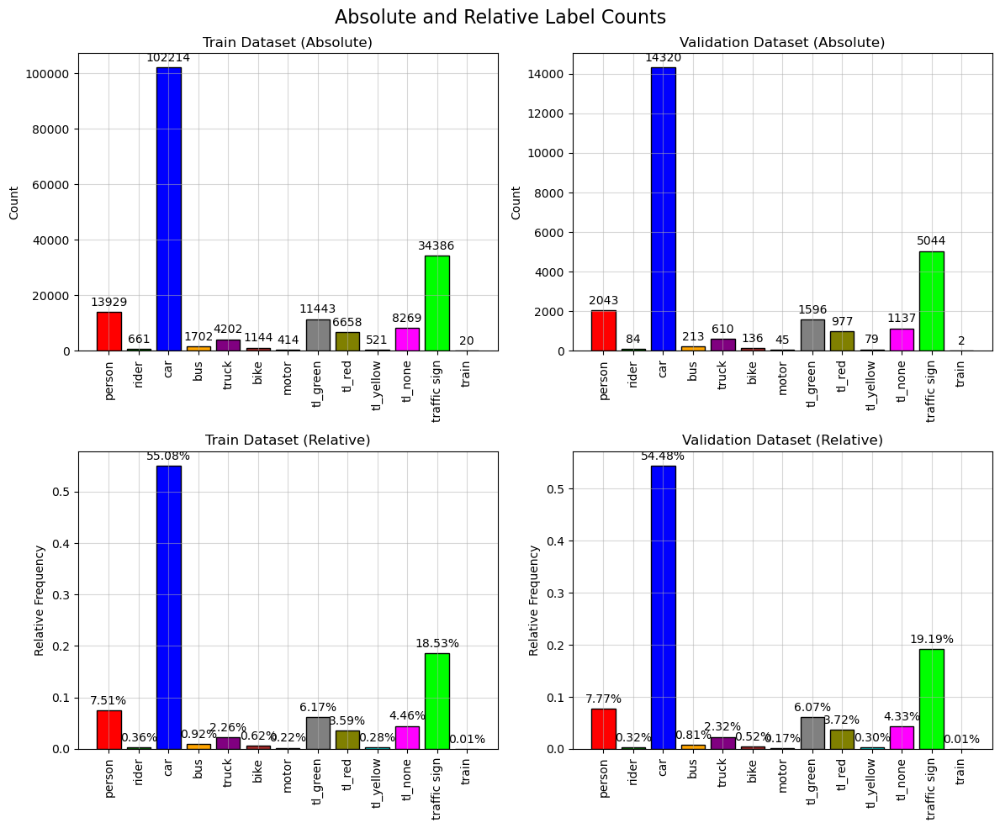

In [12]:
def count_labels(label_dir, class_names):
    counts = np.zeros(len(class_names))

    for label_file in os.listdir(label_dir):
        with open(os.path.join(label_dir, label_file), 'r') as file:
            for line in file:
                class_id = int(float(line.split()[0]))
                counts[class_id] += 1

    return counts

train_counts = count_labels(train_label_dir, class_names)
val_counts = count_labels(val_label_dir, class_names)

relative_train_counts = train_counts / np.sum(train_counts)
relative_val_counts = val_counts / np.sum(val_counts)

# Plotting
fig, axs = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
fig.suptitle('Absolute and Relative Label Counts', fontsize=16)
x = np.arange(len(class_names))  # Class indices for bar positions
def plot_counts(ax, counts, title, is_relative=False):
    bars = ax.bar(x, counts, color=colors, edgecolor='black')
    ax.set_title(title)
    ax.set_xticks(x)
    ax.set_xticklabels(class_names, rotation=90)
    ax.set_ylabel('Count' if not is_relative else 'Relative Frequency')
    ax.grid(True,alpha = 0.5)

    for bar, count in zip(bars, counts):
        label = f'{int(count)}' if not is_relative else f'{count / np.sum(counts):.2%}'
        ax.annotate(label, xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()), xytext=(0, 3),
                    textcoords="offset points", ha='center', va='bottom')

plot_counts(axs[0, 0], train_counts, 'Train Dataset (Absolute)')
plot_counts(axs[0, 1], val_counts, 'Validation Dataset (Absolute)')
plot_counts(axs[1, 0], relative_train_counts, 'Train Dataset (Relative)', is_relative=True)
plot_counts(axs[1, 1], relative_val_counts, 'Validation Dataset (Relative)', is_relative=True)

plt.tight_layout()
plt.show()


From these plots we can see, that the most frequent labels, like car, traffic sign and person make up a huge majority of the labels, while other labels like rider, train or motorcycle rarely appear. The rare appearance might make it hard for our model to detect riders or trains in the real world.

## Object Count per Image

In the next plot we will look at the distribution of how may objects each picture has.

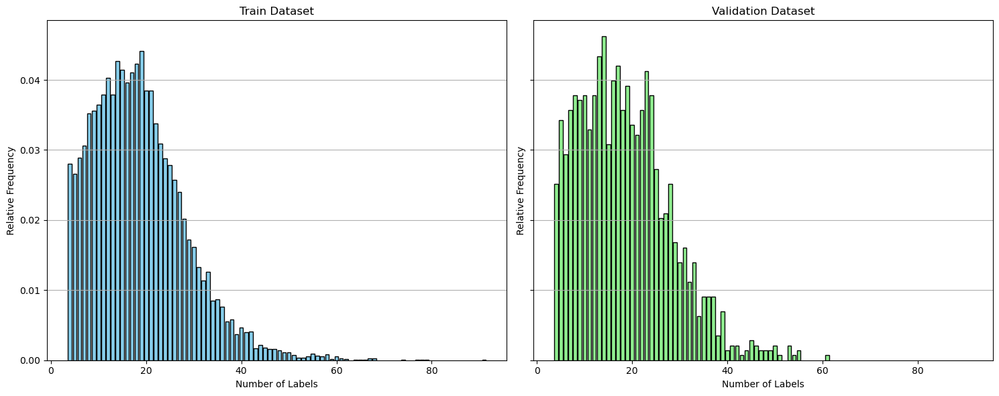

In [13]:
def count_labels(label_dir):
    label_counts = [len(open(os.path.join(label_dir, f)).readlines()) for f in os.listdir(label_dir)]
    return np.array(label_counts)

def plot_on_ax_rel_freq(ax, label_counts, color, title):
    values, counts = np.unique(label_counts, return_counts=True)
    relative_counts = counts / counts.sum()

    ax.bar(values, relative_counts, color=color, edgecolor='black', align='center')
    ax.set_title(title)
    ax.set_xlabel('Number of Labels')
    ax.set_ylabel('Relative Frequency')
    ax.grid(axis='y')


train_label_counts = count_labels(train_label_dir)
val_label_counts = count_labels(val_label_dir)

# Plotting
fig, axs = plt.subplots(1, 2, figsize=(15, 6), sharey=True)
plot_on_ax_rel_freq(axs[0], train_label_counts, 'skyblue', 'Train Dataset')
plot_on_ax_rel_freq(axs[1], val_label_counts, 'lightgreen', 'Validation Dataset')
axs[1].set_xlim(axs[0].get_xlim())

plt.tight_layout()
plt.show()

Here we can see, that the distribution looks almost alike, but you can clearly see, that the validation set is not as smooth, because it has less samples.

## Widths and Heights of each Bounding Box


Next we look at the widths and heights of the labels in some scatterplots.

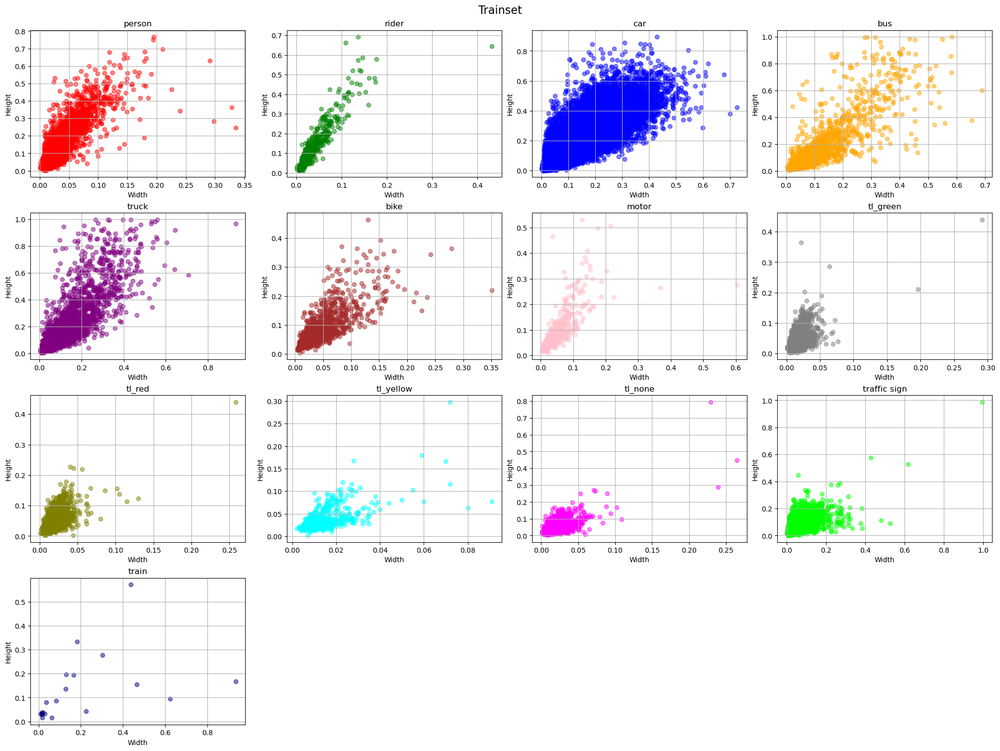

In [14]:
def plot_bb_width_height(label_dir, class_names, colors):
    bbox_sizes = {class_name: {'widths': [], 'heights': []} for class_name in class_names}

    for label_file in os.listdir(label_dir):
        with open(os.path.join(label_dir, label_file), 'r') as file:
            for line in file:
                class_id, _, _, width, height = map(float, line.split())
                bbox_sizes[class_names[int(class_id)]]['widths'].append(width)
                bbox_sizes[class_names[int(class_id)]]['heights'].append(height)

    # Plotting
    fig, axs = plt.subplots(4, 4, figsize=(20, 15), constrained_layout=True)
    for i, class_name in enumerate(class_names):
        ax = axs[i // 4, i%4]
        widths = bbox_sizes[class_name]['widths']
        heights = bbox_sizes[class_name]['heights']
        ax.scatter(widths, heights, alpha=0.5, color=colors[i])
        ax.set_title(f'{class_name}')
        ax.set_xlabel('Width')
        ax.set_ylabel('Height')
        ax.grid(True)


    for i in range(len(class_names), 16):
        axs.flatten()[i].axis('off')

    return fig



fig = plot_bb_width_height(train_label_dir, class_names, colors)
fig.suptitle('Trainset', fontsize=16)
plt.show()

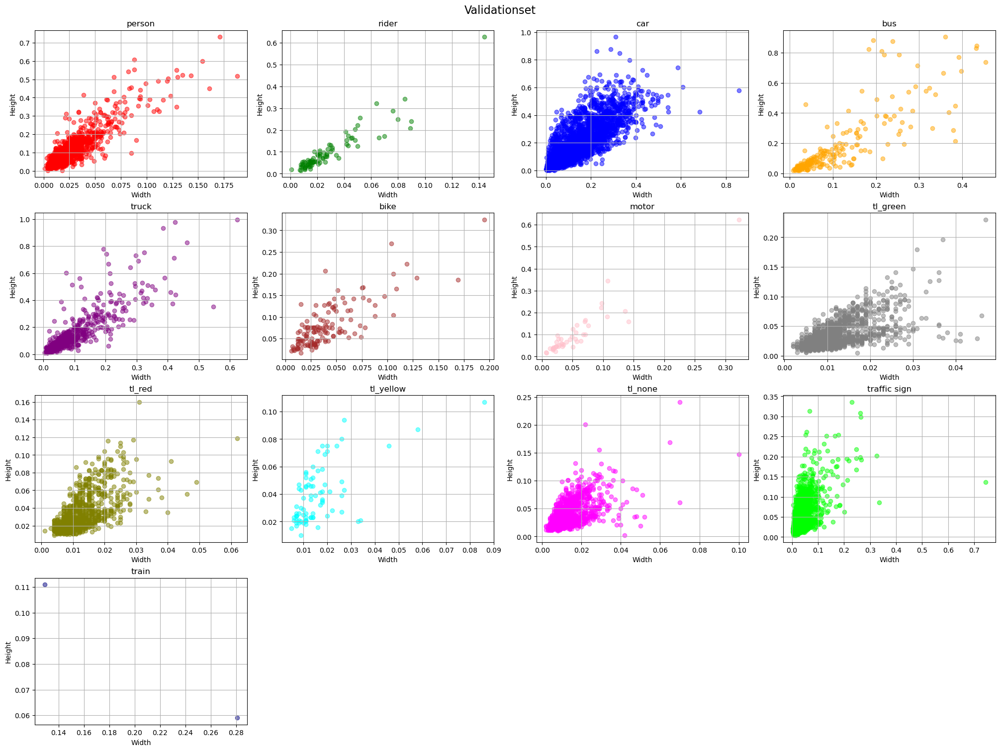

In [15]:
fig = plot_bb_width_height(val_label_dir,class_names,colors)
fig.suptitle('Validationset', fontsize=16)
plt.show()

Here we can also see, that our datasets are mostly similar, but the validationset has more variance, because it consists of less samples. You can see the lack of samples especially well in class train of the validation set, where we only have 2 samples.

## Example Images

Here we finally look at two example images which show how our dataset looks like.

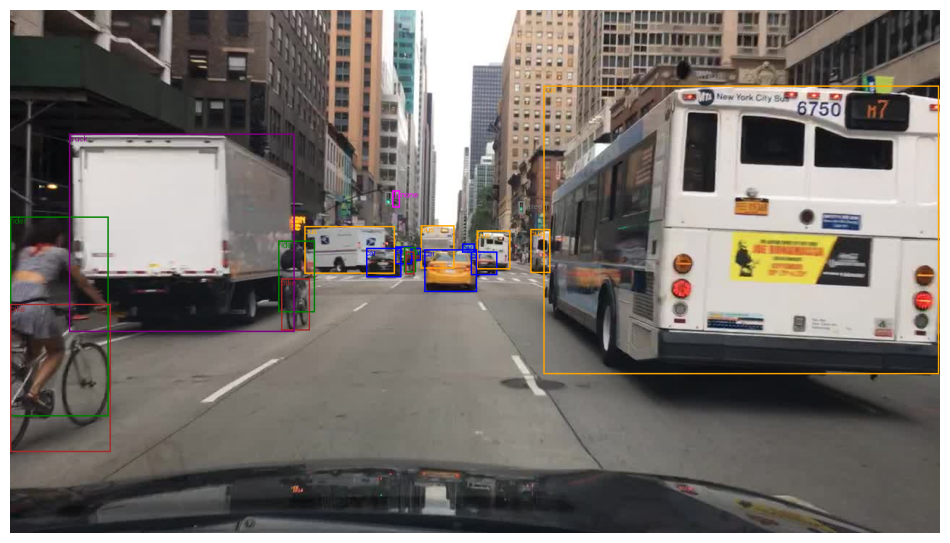

In [16]:
def create_image_and_labels(image_path, label_path, class_names, colors):
    image = Image.open(image_path)
    image_width, image_height = image.size
    draw = ImageDraw.Draw(image)

    with open(label_path, 'r') as file:
        for line in file:
            class_id, x_center, y_center, width, height = map(float, line.split())
            x_center, y_center, width, height = x_center * image_width, y_center * image_height, width * image_width, height * image_height
            left, top, right, bottom = x_center - width / 2, y_center - height / 2, x_center + width / 2, y_center + height / 2
            color = colors[int(class_id)]
            draw.rectangle(((left, top), (right, bottom)), outline=color, width=2)
            draw.text((left, top), f"{class_names[int(class_id)]}", fill=color)

    return image

image_path = "datasets/yolo-bdd10k/images/train/3dc827e3-f3a359ce.jpg"
label_path = "datasets/yolo-bdd10k/labels/train/3dc827e3-f3a359ce.txt"

image_with_boxes = create_image_and_labels(image_path, label_path, class_names, colors)

plt.figure(figsize=(12, 8))
plt.imshow(image_with_boxes)
plt.axis('off')
plt.show()

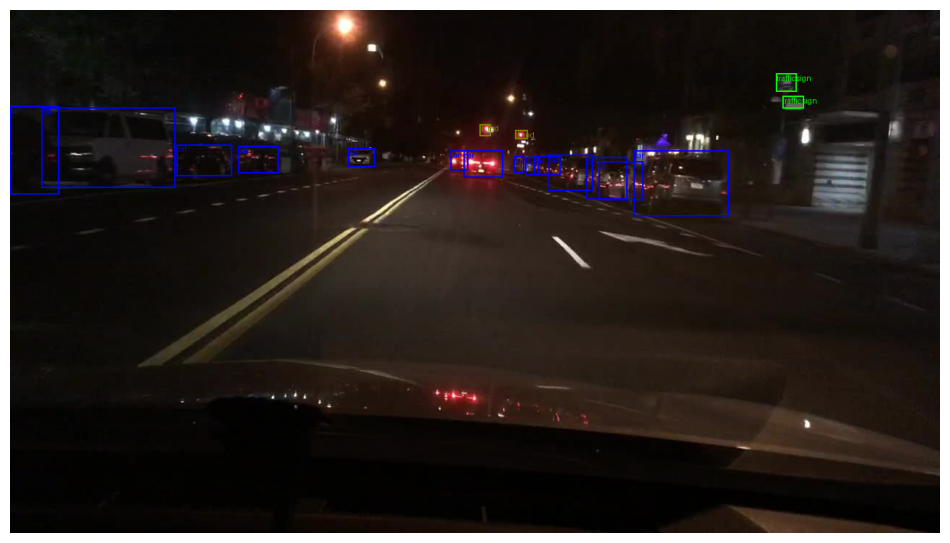

In [17]:
image_path = "datasets/yolo-bdd10k/images/train/9561e2f8-f991862f.jpg"
label_path = "datasets/yolo-bdd10k/labels/train/9561e2f8-f991862f.txt"

image_with_boxes = create_image_and_labels(image_path, label_path, class_names, colors)

plt.figure(figsize=(12, 8))
plt.imshow(image_with_boxes)
plt.axis('off')
plt.show()

# Training

In this section, you must explicitly explain your training process and the code to perform it.

In [18]:
#! unzip "drive/MyDrive/JKU/ItAV/task1/runs.zip"

In [19]:
# !nvidia-smi
# !mkdir model

For all experiments the pretrained Yolov8 Large model is used which can be found here: https://github.com/ultralytics/ultralytics



In [20]:
# Load a COCO-pretrained YOLOv8n model
coco_model_path = "./model/yolov8l.pt"
model = YOLO(coco_model_path)

# Display model information (optional)
model.info()

YOLOv8l summary: 365 layers, 43691520 parameters, 0 gradients


(365, 43691520, 0, 0.0)

To monitor loss and evaluation metrics during training we use Tensorboard for more informed decisions when changing the hyperparameters:

In [21]:
%load_ext tensorboard
%tensorboard --logdir runs/detect
from tensorboard import notebook
#notebook.list() # View open TensorBoard instances

## Reference experiment

This section should detail the results of the reference experiment where you use your selected model in the selected dataset WITHOUT training. It should include training metrics and a detailed explanation of the algorithm's performances.

We have two approaches to allow for a fair comparison between untrained and trained model.
1. The first model is completely untrained and has never seen the BDD100k images, however it is hard to compare the validation set statistics of this model to our dataset, since the model does not know the labels of the dataset. (In the video section you can see a video for this model)
2. The second model is trained for 1 epoch, to at least allow for adjustments to the newly introduced and unseen labels.

In [72]:
validation_results_before_training = model.val(data='./datasets/yolo-bdd10k/dataset.yaml',
                                         model=coco_model_path,
                                         task='detect',
                                         mode='val',
                                         imgsz=640,
                                         batch=16,
                                         plots=True)

Ultralytics YOLOv8.1.16 🚀 Python-3.12.2 torch-2.2.1 CUDA:0 (NVIDIA GeForce RTX 3070, 8191MiB)
YOLOv8l summary (fused): 268 layers, 43668288 parameters, 0 gradients


val: Scanning C:\Users\tom\Documents\JKU\IAV\Assignment1\datasets\yolo-bdd10k\labels\val.cache... 1429 images, 0 backgr
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 90/90 [00:52


                   all       1429      26286      0.261       0.11      0.116     0.0645
                person       1429       2043      0.713      0.541      0.595      0.301
               bicycle       1429         84     0.0161     0.0119     0.0124    0.00375
                   car       1429      14320      0.756      0.563      0.656        0.4
            motorcycle       1429        213          0          0          0          0
              airplane       1429        610          0          0    0.00341    0.00239
                   bus       1429        136          0          0          0          0
                 train       1429         45          0          0          0          0
                 truck       1429       1596          0          0   4.32e-05   1.08e-05
                  boat       1429        977          1          0          0          0
         traffic light       1429         79     0.0119      0.304    0.00949    0.00316
          fire hydran

We will only show the predictions since the labels are unknown to the model:

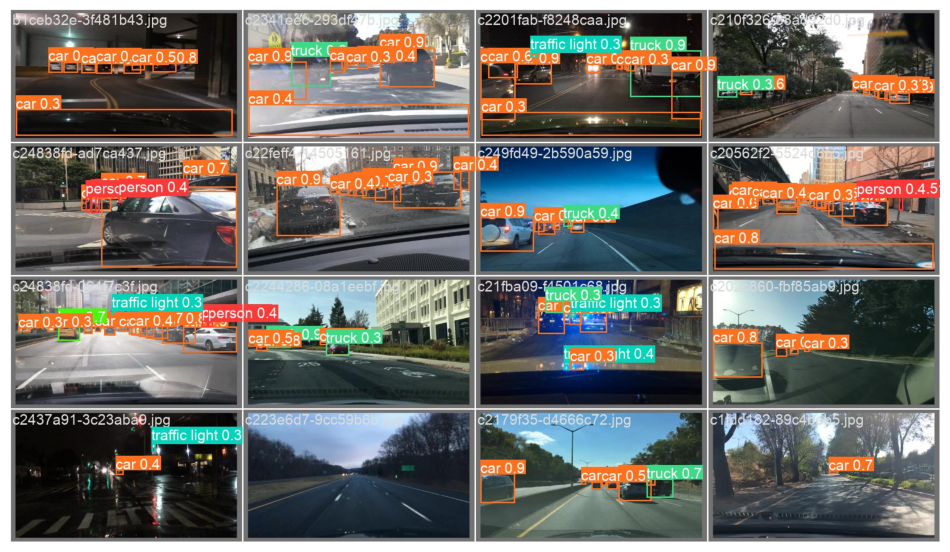

In [22]:
img = Image.open("./runs/detect/val/val_batch0_pred.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

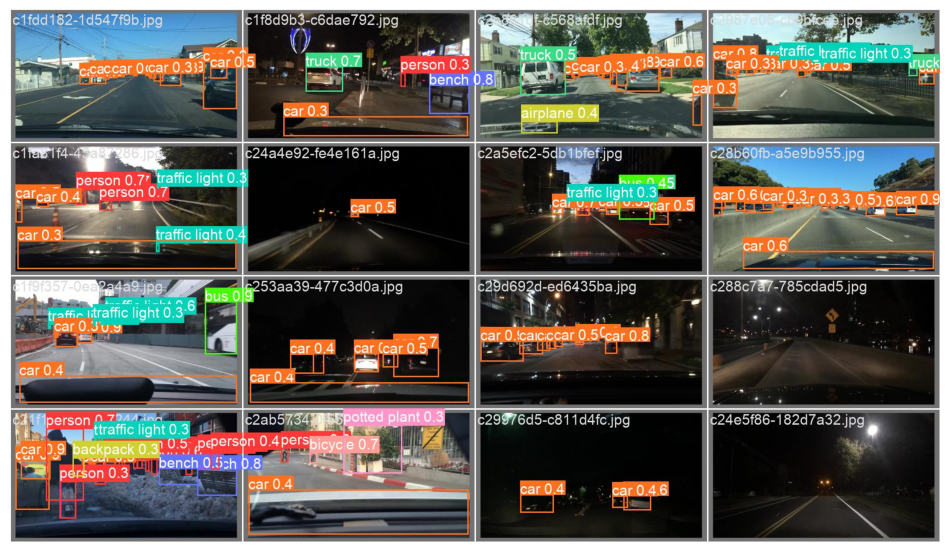

In [23]:
img = Image.open("./runs/detect/val/val_batch1_pred.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

We can notice that the own car gets detected by Yolo which is not the case for the labels of the BDD100k dataset. Also the traffic signs are sometimes not detected and the states of the traffic lights are not covered by the labels of the original model. We also look at the performance in 3 selected videos from the BDD100k Train set:

In [26]:
# Model 2
results = model.train(
    name='train_1epoch',
    task='detect',
    mode='val',
    model=coco_model_path,
    data='./datasets/yolo-bdd10k/dataset.yaml',
    epochs=1,
    patience=5,
    batch=-1,
    imgsz=640,
    cache=True,
    device='cuda:0',
    workers=8,
    pretrained=coco_model_path,
    verbose=True,
    seed=random_seed,
    freeze=None,
    plots=True,
    #**augmentations
    )

New https://pypi.org/project/ultralytics/8.1.29 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.16 🚀 Python-3.12.2 torch-2.2.1 CUDA:0 (NVIDIA GeForce RTX 3070, 8191MiB)
engine\trainer: task=detect, mode=train, model=./model/yolov8l.pt, data=./datasets/yolo-bdd10k/dataset.yaml, epochs=1, time=None, patience=5, batch=-1, imgsz=640, save=True, save_period=-1, cache=True, device=cuda:0, workers=8, project=None, name=train_1epoch, exist_ok=False, pretrained=./model/yolov8l.pt, optimizer=auto, verbose=True, seed=2024, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retin

train: Scanning C:\Users\tom\Documents\JKU\IAV\Assignment1\datasets\yolo-bdd10k\labels\train.cache... 9980 images, 20 b
train: Caching images (6.4GB True): 100%|██████████| 10000/10000 [00:14<00:00, 668.77it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning C:\Users\tom\Documents\JKU\IAV\Assignment1\datasets\yolo-bdd10k\labels\val.cache... 1429 images, 0 backgr
val: Caching images (0.9GB True): 100%|██████████| 1429/1429 [00:02<00:00, 662.22it/s]


Plotting labels to runs\detect\train_1epoch\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000588, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\train_1epoch
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      3.48G      1.362      1.036      1.068        100        640: 100%|██████████| 2500/2500 [06:21<00:00,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 179/179 [00:


                   all       1429      26286      0.404      0.292      0.295      0.148

1 epochs completed in 0.114 hours.
Optimizer stripped from runs\detect\train_1epoch\weights\last.pt, 87.6MB
Optimizer stripped from runs\detect\train_1epoch\weights\best.pt, 87.6MB

Validating runs\detect\train_1epoch\weights\best.pt...
Ultralytics YOLOv8.1.16 🚀 Python-3.12.2 torch-2.2.1 CUDA:0 (NVIDIA GeForce RTX 3070, 8191MiB)
Model summary (fused): 268 layers, 43616631 parameters, 0 gradients


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 179/179 [00:


                   all       1429      26286      0.403      0.293      0.295      0.148
                person       1429       2043      0.648      0.485      0.535      0.244
                 rider       1429         84      0.268      0.157     0.0944     0.0431
                   car       1429      14320       0.77      0.588      0.674      0.397
                   bus       1429        213      0.355      0.427      0.348      0.257
                 truck       1429        610       0.47      0.385      0.368      0.246
                  bike       1429        136      0.675      0.244      0.274      0.122
                 motor       1429         45          0          0       0.02    0.00758
              tl_green       1429       1596       0.55      0.382      0.386      0.132
                tl_red       1429        977      0.475      0.377      0.337      0.106
             tl_yellow       1429         79          0          0     0.0311     0.0103
               tl_non

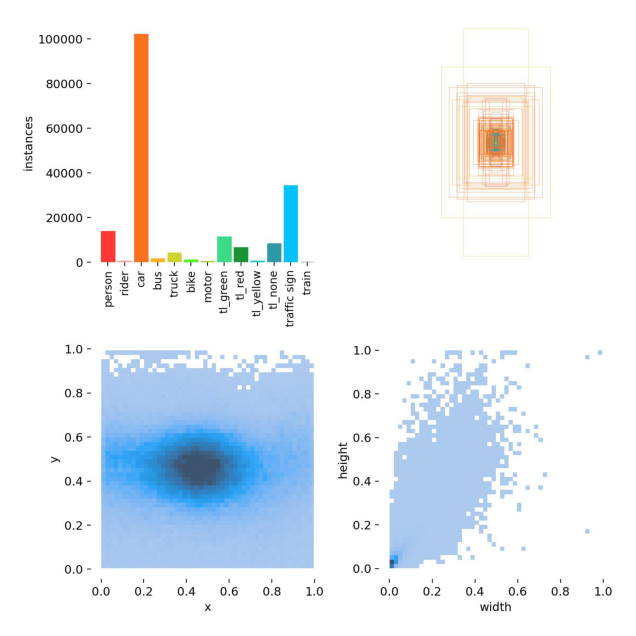

In [27]:
img = Image.open("./runs/detect/train_1epoch/labels.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

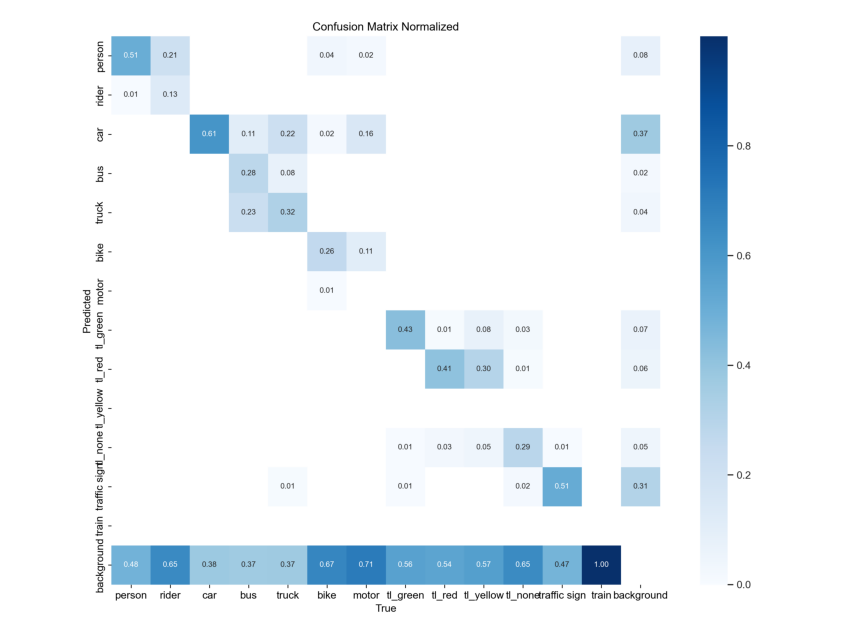

In [28]:
img = Image.open("./runs/detect/train_1epoch/confusion_matrix_normalized.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

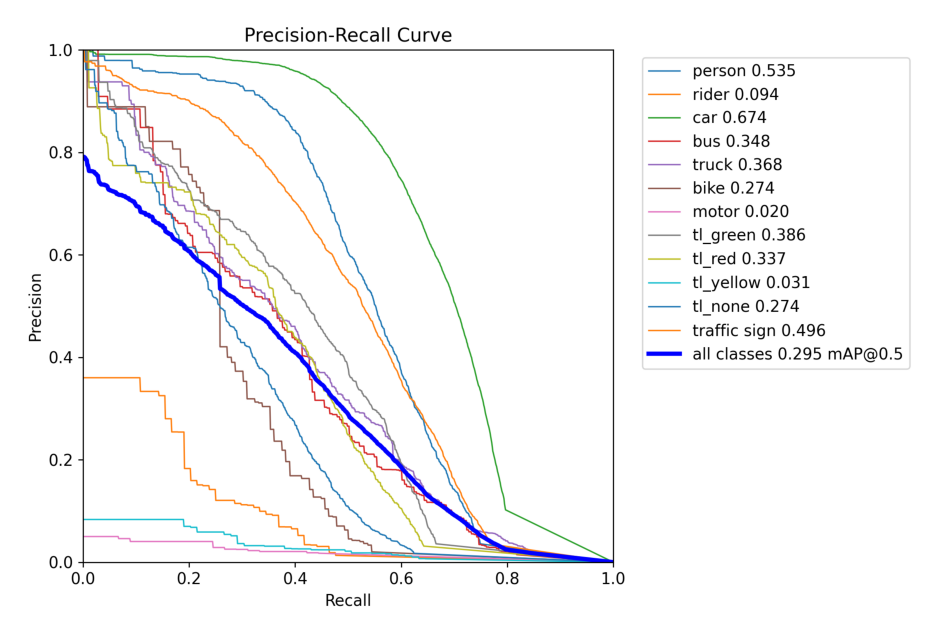

In [29]:
img = Image.open("./runs/detect/train_1epoch/PR_curve.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

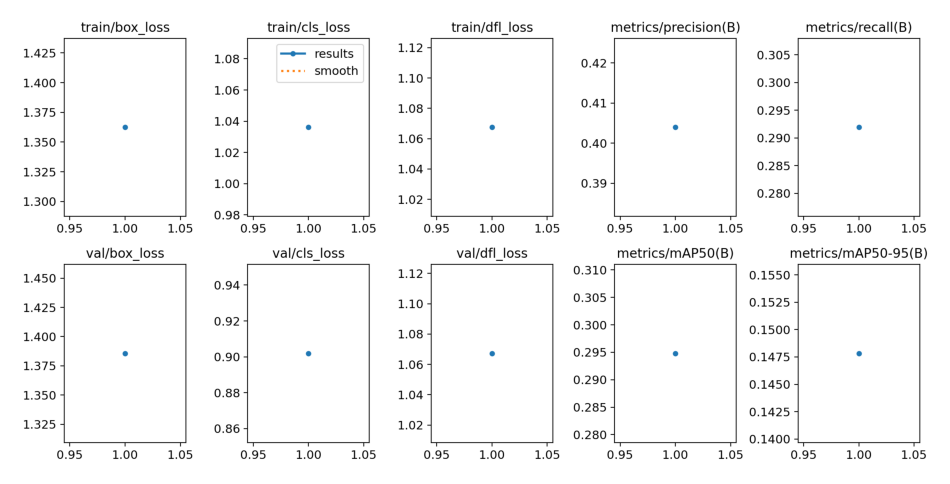

In [30]:
img = Image.open("./runs/detect/train_1epoch/results.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

### Labels

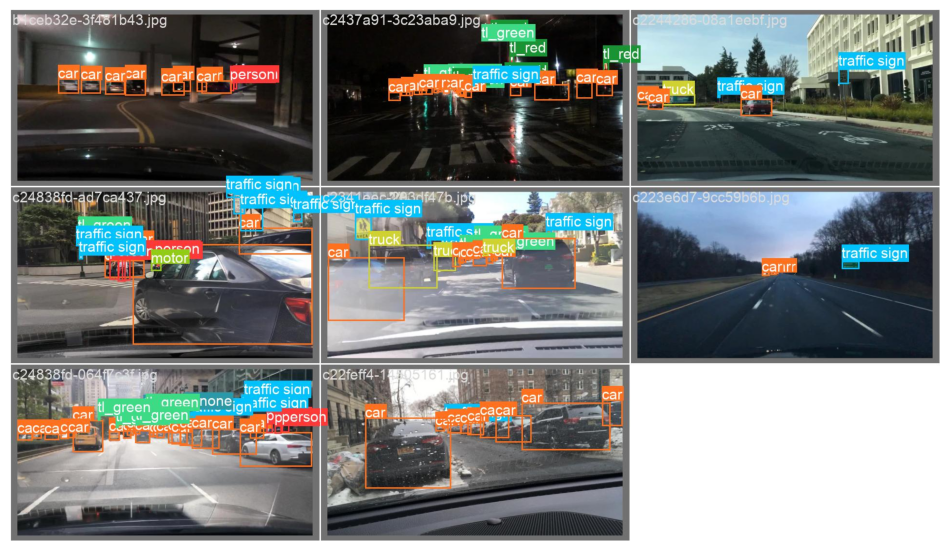

In [31]:
img = Image.open("./runs/detect/train_1epoch/val_batch0_labels.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

### Prediction

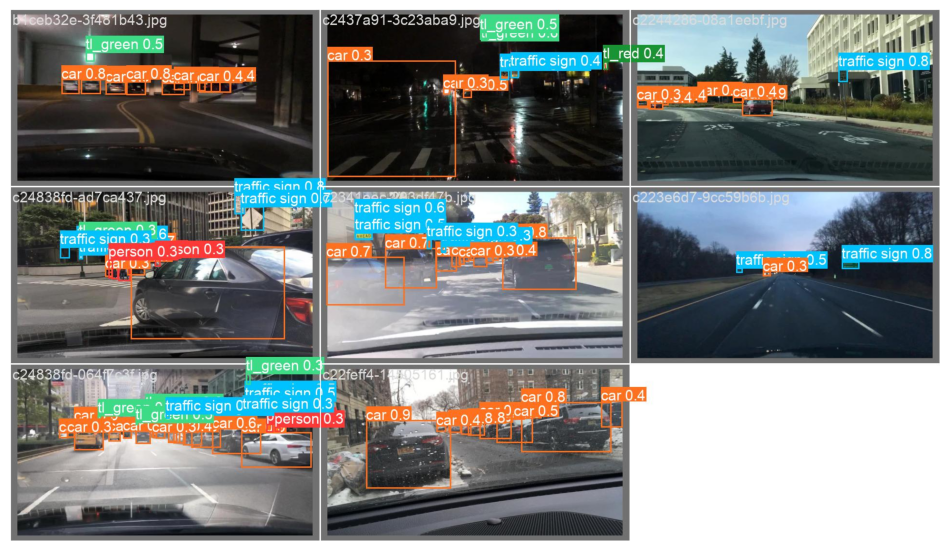

In [32]:
img = Image.open("./runs/detect/train_1epoch/val_batch0_pred.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

## Improve on the reference
This section should detail the results of the reference experiment where you use your selected model in the selected dataset AFTER training. It should include training metrics and a detailed explanation of the algorithm's performances.

In the following cells we can adjust all Hyperparameters for the model. 

**First training attempts:**

Next to some tweaks to the learning rate we increase the importance of the cls loss term, since the model confuses many objects with the background (maybe because of the skewed class distributiun). We also change the default augmentations applied by YoloV8. For example we disable mixup and mosaic augmentation and adjust values for translation, scale, perspective. Extra care is put on augmenting the image in thoughtful ways to accommodate the traffic setting. For example, while a horizontal flip can make sense to better detect vehicles, a vertical flip would never occur (not in a normal setting) in real life, which is why we disable this kind of augmentation. Additionally we install the albumentation library to enable albumentations such as

- Blur(p=0.01, blur_limit=(3, 7))
- MedianBlur(p=0.01, blur_limit=(3, 7))
- ToGray(p=0.01)
- CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

**Final training attempts:**

We compared our first trained models to training with the default yolo hyperparameters. We noticed that most of our hyperparameter changes rather hurt the performance over time instead of improving upon it. We also experimented with freezing the first few layers, but only made learning faster not better in our tested settings. Especially the losses and learning rate seem to be already well tuned by the Yolo developers. This is why we focused on improving/increasing the augmentation of the model and using the following parameters to train our best model:

Main changes are:
- increased scaling since there are many small annotations in the dataset,
- increased HSV values to improve the performance in different environmental settings like night or rain
- slightly decreased translation

You can see all models which were trained for a reasonable time in the tensorboard.

In [33]:
# Augmentations / Hyperparameters:
####################################
augmentations = {
'lr0': 0.01,  # initial learning rate (i.e. SGD=1E-2, Adam=1E-3)
'lrf': 0.01,  # final learning rate (lr0 * lrf)
'momentum': 0.937,  # SGD momentum/Adam beta1
'weight_decay': 0.0005,  # optimizer weight decay 5e-4
'warmup_epochs': 1.0,  # warmup epochs (fractions ok)
'warmup_momentum': 0.8,  # warmup initial momentum
'warmup_bias_lr': 0.1, # warmup initial bias lr
'box': 7.5,  # box loss gain
'cls': 0.5,  # cls loss gain (scale with pixels)
'dfl': 1.5,  # dfl loss gain
#'pose': 12.0,  # pose loss gain
#'kobj': 1.0,  # keypoint obj loss gain
'label_smoothing': 0.0,  # label smoothing (fraction)
#'nbs': 64  # nominal batch size
'hsv_h': 0.016,  # image HSV-Hue augmentation (fraction)
'hsv_s': 0.8,  # image HSV-Saturation augmentation (fraction)
'hsv_v': 0.5,  # image HSV-Value augmentation (fraction)
'degrees': 0.0,  # image rotation (+/- deg)
'translate': 0.1,  # image translation (+/- fraction)
'scale': 0.6,  # image scale (+/- gain)
'shear': 0.0,  # image shear (+/- deg) from -0.5 to 0.5
'perspective': 0.0,  # image perspective (+/- fraction), range 0-0.001
'flipud': 0.0,  # image flip up-down (probability)
'fliplr': 0.5,  # image flip left-right (probability)
'mosaic': 1.0,  # image mosaic (probability)
'mixup': 0.0,  # image mixup (probability)
'copy_paste': 0.0,  # segment copy-paste (probability)
'erasing': 0.5,
}

**Example images augmentation:**
In the following image you can see an example for what our augmentation looks like. While at first we were very skeptical to use mosaic augmentation it turned out to improve the mAP50 metric significantly over time. To stabilize the model towards the end of training the mosaic augmentation is removed in the last 10 training epochs.

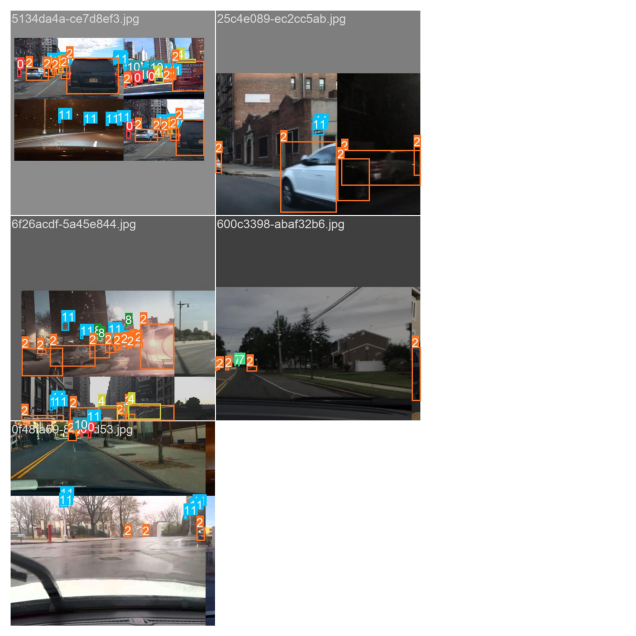

In [34]:
img = Image.open("runs/detect/train6/train_batch0.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

In [35]:
# Train the model on the COCO8 example dataset for 80 epochs
results = model.train(
    task='detect',
    mode='train',
    model=coco_model_path,
    data='./datasets/yolo-bdd10k/dataset.yaml',
    epochs=80,
    patience=5,
    batch=-1,
    imgsz=640,
    cache=True,
    device='cuda:0',
    workers=8,
    pretrained=coco_model_path,
    verbose=True,
    seed=random_seed,
    #resume=True,
    #dropout=0.2,
    #freeze=3,
    plots=True,
    **augmentations
    )
# Training print ommited (very lengthy)

### Validation and evaluation

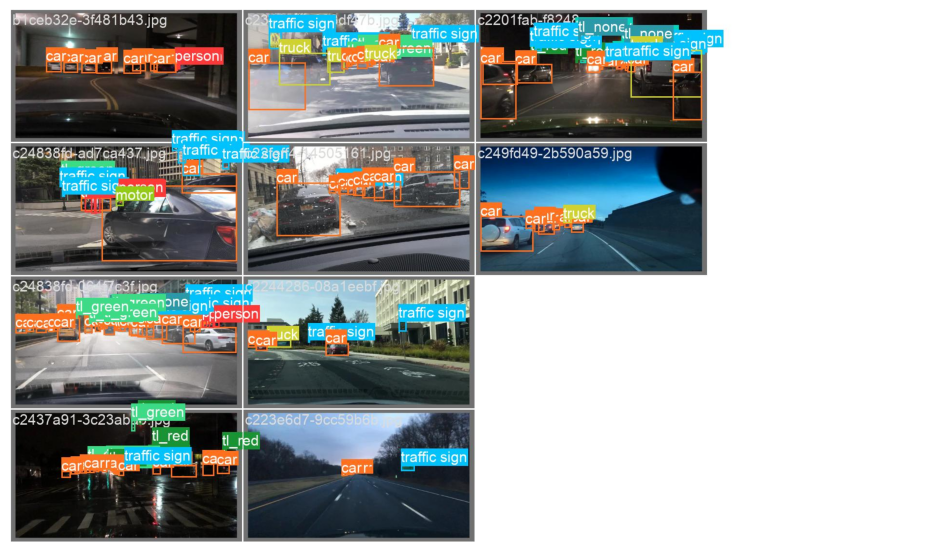

In [37]:
img = Image.open("./runs/detect/train6/val_batch0_labels.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

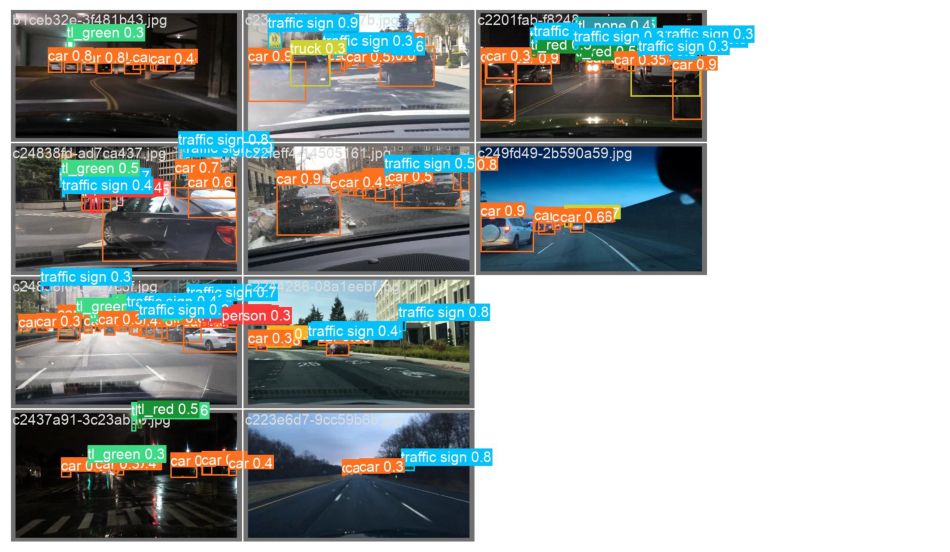

In [38]:
img = Image.open("./runs/detect/train6/val_batch0_pred.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

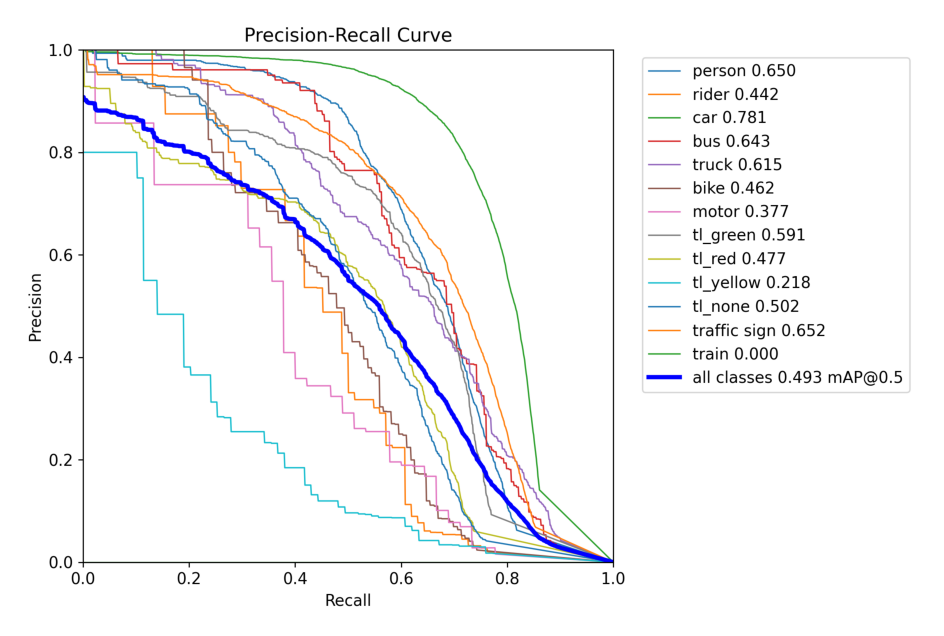

In [55]:
img = Image.open("./runs/detect/train6/PR_curve.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

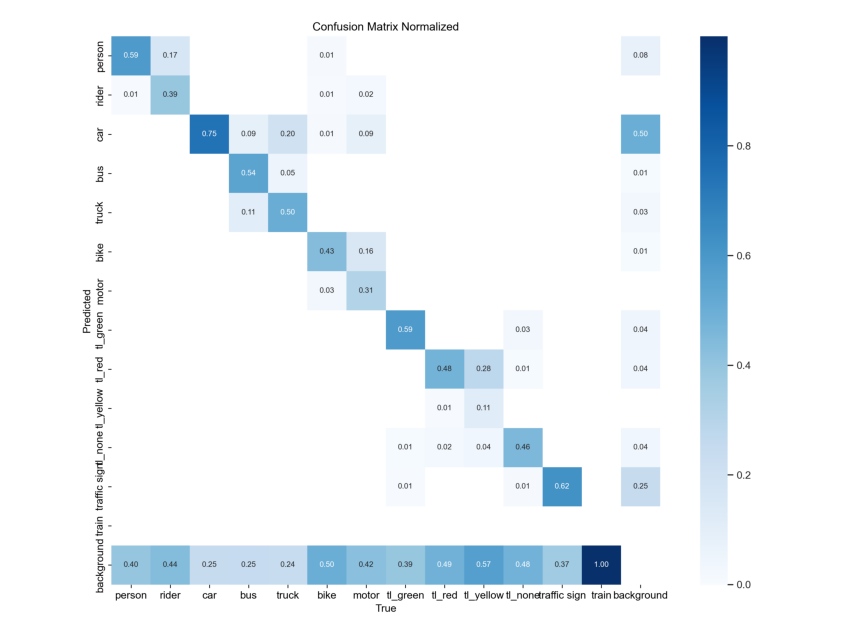

In [39]:
img = Image.open("./runs/detect/train6/confusion_matrix_normalized.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

In this normalized confusion matrix we can observe which classes get confused the most frequent.

Some observations based on this table:
- The classes car, traffic sign and person are the most stable.
- Cars sometimes get confused with trucks and busses
- Red traffic lights sometimes get confused with yellow traffic lights
- Trains are not detected at all, since we only have very few instances in our training set.
- Generally the model misses many objects by classifying them as background, ideally we would like to have an identity matrix.

Compared to our almost untrained model we see significantly increased diagonal values confirming improvements after our training.

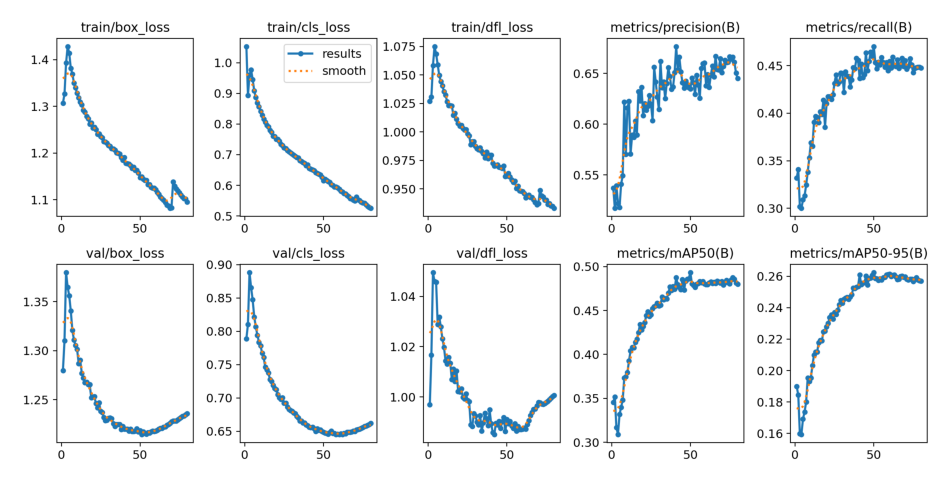

In [40]:
img = Image.open("./runs/detect/train6/results.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

The loss curves steadily decrease on both the training and validation set in the beginning, but seem to increase after around 55 epochs which means we overfit on the training data towards the end of training. Using a larger split of the BDD100k dataset or even more augmentation could alleviate this issue. There is also a bump in the last 10 epochs when mosaic augmentation is disabled.

The best metric we achieve is around 0.49 in training epoch 50. This is an epoch right before overfitting, which we can also observe by the negative tendency of the metrics after this epoch.

# Video example:

In [42]:
from IPython.display import HTML
from base64 import b64encode

def predict_video(source, model, device='cuda:0', save=True, stream=False, show=False, name=None):
    cap = cv2.VideoCapture(source)
    length = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    start = time.time()
    results = model(source, stream=stream, save=save, show=show, device=device, verbose=False, name=name)  # generator of Results objects
    end = time.time()
    passed = end - start
    if passed != 0:
        print(source, f" Video successfully predicted in {passed} seconds: around {length/passed} fps")
    return 

def display_video(filename):
    mp4 = open(filename,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML("""
    <video controls width=640>
          <source src="%s" type="video/mp4">
    </video>++++++++++
    """ % data_url)

### Untrained Model:

In [43]:
# Model 1
model = YOLO('./model/yolov8l.pt') # Original Yolo large model
source1 = './datasets/example_video/0000f77c-6257be58.mov'
source2 = './datasets/example_video/00a395fe-d60c0b47.mov'
source3 = './datasets/example_video/00852c8f-14cf1e60.mov'

# Run inference on the source
predict_video(source1, model, name="predict_yolo_unmodified")
predict_video(source2, model, name="predict_yolo_unmodified")
predict_video(source3, model, name="predict_yolo_unmodified")


WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

Results saved to runs\detect\predict_yolo_unmodified
./datasets/example_video/0000f77c-6257be58.mov  Video successfully predicted in 36.61615562438965 seconds: around 33.236695093937406 fps

WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(s

In [ ]:
### Convert videos to .mp4
## Model 1:
# !ffmpeg -i ./runs/detect/predict_yolo_unmodified/0000f77c-6257be58.avi ./runs/detect/predict_yolo_unmodified/0000f77c-6257be58.mp4
# !ffmpeg -i ./runs/detect/predict_yolo_unmodified/00a395fe-d60c0b47.avi ./runs/detect/predict_yolo_unmodified/00a395fe-d60c0b47.mp4
# !ffmpeg -i ./runs/detect/predict_yolo_unmodified/00852c8f-14cf1e60.avi ./runs/detect/predict_yolo_unmodified/00852c8f-14cf1e60.mp4
# !ffmpeg -i ./runs/detect/predict_yolo_unmodified/IMG_0197.avi ./runs/detect/predict_yolo_unmodified/IMG_0197.mp4

In [46]:
display_video("./runs/detect/predict_yolo_unmodified/00852c8f-14cf1e60.mp4")

### Trained Models:

In [48]:
# Model 1
model = YOLO('./model/train6_best.pt') # Our best trained model
source1 = './datasets/example_video/0000f77c-6257be58.mov'
source2 = './datasets/example_video/00a395fe-d60c0b47.mov'
source3 = './datasets/example_video/00852c8f-14cf1e60.mov'

# Run inference on the source
predict_video(source1, model, name="predict_train6_bestmodel")
predict_video(source2, model, name="predict_train6_bestmodel")
predict_video(source3, model, name="predict_train6_bestmodel")


WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

Results saved to runs\detect\predict_train6_bestmodel
./datasets/example_video/0000f77c-6257be58.mov  Video successfully predicted in 38.66984677314758 seconds: around 31.47154958072105 fps

WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(s

In [51]:
### Convert videos to .mp4
## Model 1:
#!ffmpeg -i ./runs/detect/predict_train6_bestmodel/0000f77c-6257be58.avi ./runs/detect/predict_train6_bestmodel/0000f77c-6257be58.mp4
#!ffmpeg -i ./runs/detect/predict_train6_bestmodel/00a395fe-d60c0b47.avi ./runs/detect/predict_train6_bestmodel/00a395fe-d60c0b47.mp4
#!ffmpeg -i ./runs/detect/predict_train6_bestmodel/00852c8f-14cf1e60.avi ./runs/detect/predict_train6_bestmodel/00852c8f-14cf1e60.mp4
#!ffmpeg -i ./runs/detect/predict_train6_bestmodel/IMG_0197.avi ./runs/detect/predict_train6_bestmodel/IMG_0197.mp4

In [54]:
Vdisplay_video("./runs/detect/predict_train6_bestmodel/00852c8f-14cf1e60.mp4")

Video analysis:

(We needed to exclude most of the videos to reduce the filesize for moodle, you can find all of our tested including our own videos on google drive: )


The videos above were taken from the BDD100k Training Dataset which is why the model might be biased and work better on this data. This is why we decided to also record our own independent videos in Linz (Europe) to test the model in a completely new setting. For privacy reasons you can find the results in the videos.zip in the submission folder. We found astonishing that our trained model worked so well in this european setting and that both traffic signs as well as traffic light state detection still worked very well in our own videos.

Yolo v8 large achieves between 30-40 frames per second which is pretty impressive for the size of the model and above classical framerate used in movies (24 fps). 

## Next steps and Summary:

Next steps to further improve performance and training could be to try and get a more even distribution of dataset samples. The class "train" was never detected since we only had 2 instances in our training set. This may be improved by using the full BDD100k dataset or taking other measures to make small classes like the "train" class more frequent and representative. However this was outside the scope for the time period of this project.

One of the most significant changes we introduced by our training was the detection of traffic light states. In the default model, traffic lights were detected but could not be evaluated. With our model we can detect the current state of the traffic light (red, green, yellow, none) and over the course of our training we noticed that this detection got more and more accurate. 

